# This is a messy exploration notebook, be warned.
 Mostly containing heatmaps of the players positions in a match to highlight where players tend to go and where events happen throughout the game.

In [20]:
from scipy import stats as sts
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt
import seaborn as sns

import utils
import stats
import pickle

In [5]:
allpositionsdf = utils.load_obj('allPlayersPositions_game')
allpositionsdf.head()

,playerid,x,y,timestamp,team,win,intplayer
0,1,560,581,0,blue,Win,1
1,1,6577,6644,60026,blue,Win,1
2,1,7320,7077,120041,blue,Win,1
3,1,7347,7600,180055,blue,Win,1
4,1,6876,7198,240065,blue,Win,1


In [6]:
# if we want to save the images we set the following variable to True
save = False

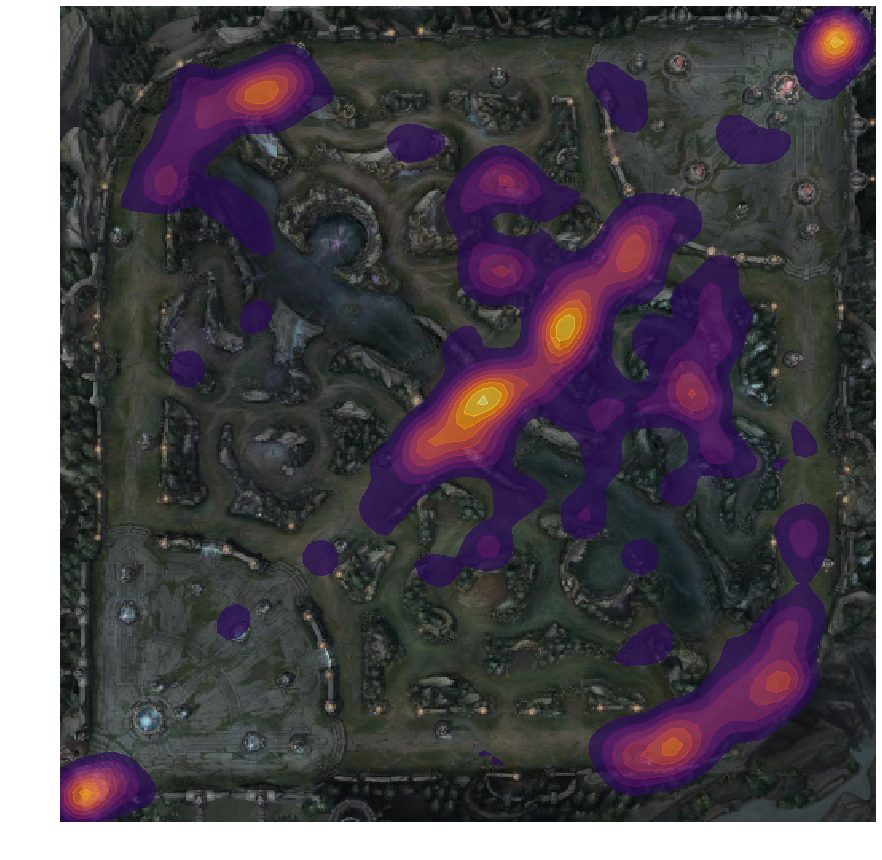

In [7]:
# generate heatmap of all players' positions
stats.genHeatmap_allpositions(allpositionsdf,save=save, imgname='heatmap_allpos')

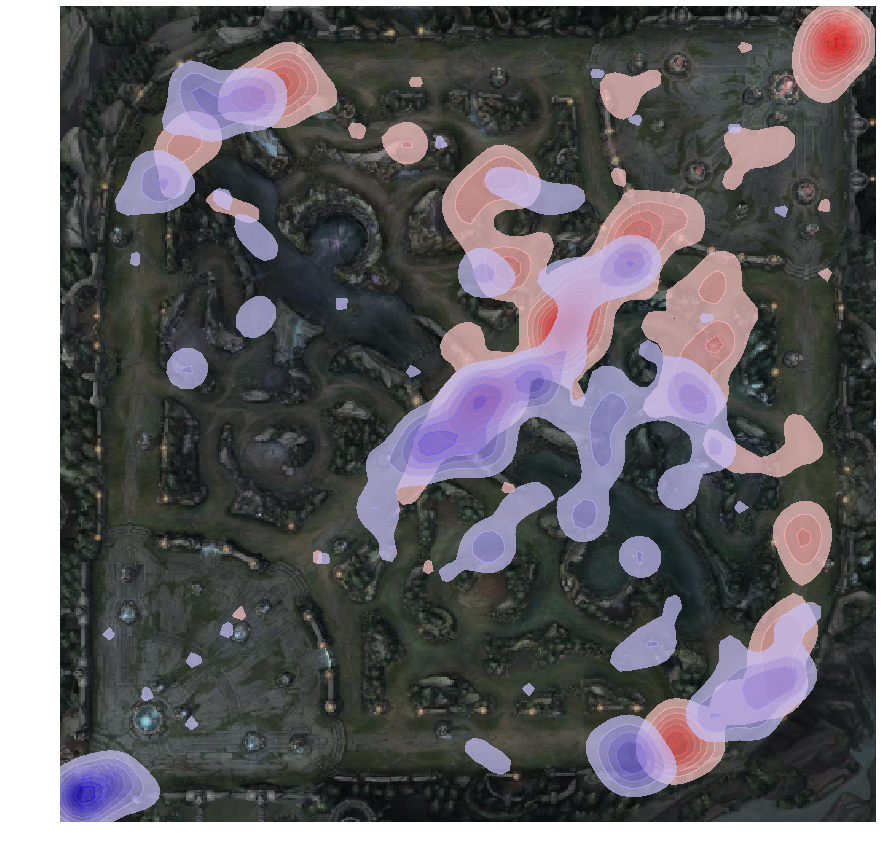

In [8]:
# same heatmap but with positions divided by team
stats.genHeatmap_allTeamPositions(allpositionsdf[allpositionsdf.team=='red'],
                            allpositionsdf[allpositionsdf.team=='blue'],
                            save=save, imgname='heatmap_allTeamsPos')

In [9]:
# load the positions and the corresponding event for a single player
allpositionsseqdf = utils.load_obj('alleventsseq_game')
allpositionsseqdf.head()

,eventtype,gametimestamp,playerId,timestamp,x,y
0,ITEM_PURCHASED,60026,4,0,1181,11358
1,ITEM_PURCHASED,60026,4,0,1181,11358
2,ITEM_PURCHASED,60026,4,0,1181,11358
3,ITEM_PURCHASED,60026,4,0,1181,11358
4,ITEM_PURCHASED,60026,8,0,9076,8630


In [10]:
# create a column to check the players' belonging team
allpositionsseqdf['team'] = allpositionsseqdf.playerId.apply(lambda x: 'blue' if int(x)<6 else 'red')

In [11]:
# how many events?
allpositionsseqdf.eventtype.unique()

array(['ITEM_PURCHASED', 'SKILL_LEVEL_UP', 'WARD_PLACED',
       'ITEM_DESTROYED', 'CHAMPION_KILL', 'ITEM_SOLD',
       'ELITE_MONSTER_KILL', 'BUILDING_KILL', 'ITEM_UNDO', 'WARD_KILL'],
      dtype=object)

In [12]:
# check some events and extract the positions only for them
killevents = ['CHAMPION_KILL', 'ELITE_MONSTER_KILL', 'BUILDING_KILL', 'ITEM_UNDO', 'WARD_KILL']
dfwards = allpositionsseqdf[allpositionsseqdf.eventtype == 'WARD_PLACED']
dfwardsk = allpositionsseqdf[allpositionsseqdf.eventtype == 'WARD_KILL']

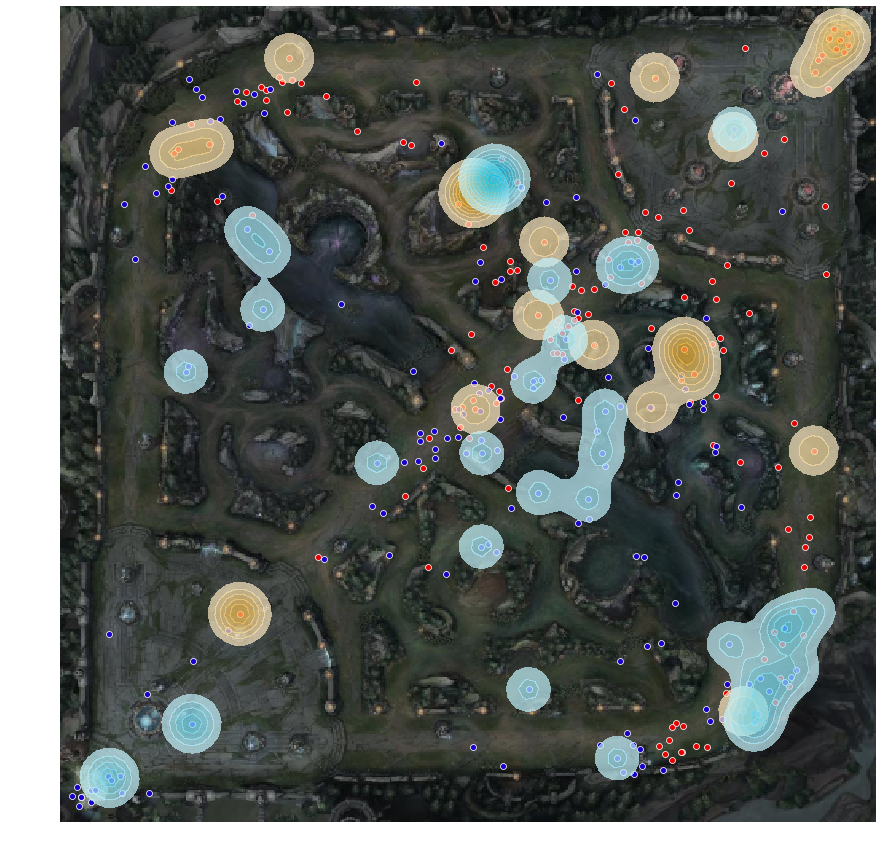

In [18]:
# champion kill heatmap: the distribution of killers in the map is given by a stronger color.
stats.genHeatmap_allTeamPositions_withEvent(allpositionsdf[allpositionsdf.team=='red'],
                                  allpositionsdf[allpositionsdf.team=='blue'],
                                  eventname='CHAMPION_KILL',
                                  eventdf=allpositionsseqdf[allpositionsseqdf.eventtype == 'CHAMPION_KILL'], 
                                  bw=300, save=save, imgname='heatmap_')

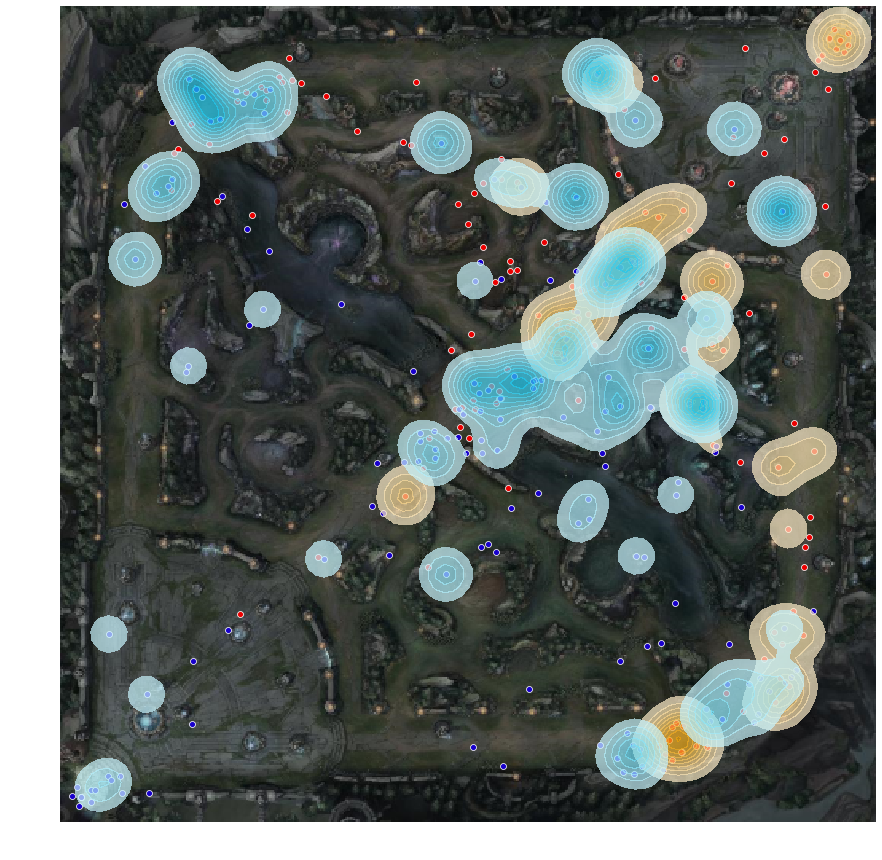

In [14]:
# plot the players' positions and their positions when an event has been triggered
# in this case, ward placed
# what can we see from this heatmap?
stats.genHeatmap_allTeamPositions_withEvent(allpositionsdf[allpositionsdf.team=='red'],
                                  allpositionsdf[allpositionsdf.team=='blue'],
                                  eventname='WARD_PLACED',
                                  eventdf=dfwards, 
                                  bw=300, save=save, imgname='heatmap_')

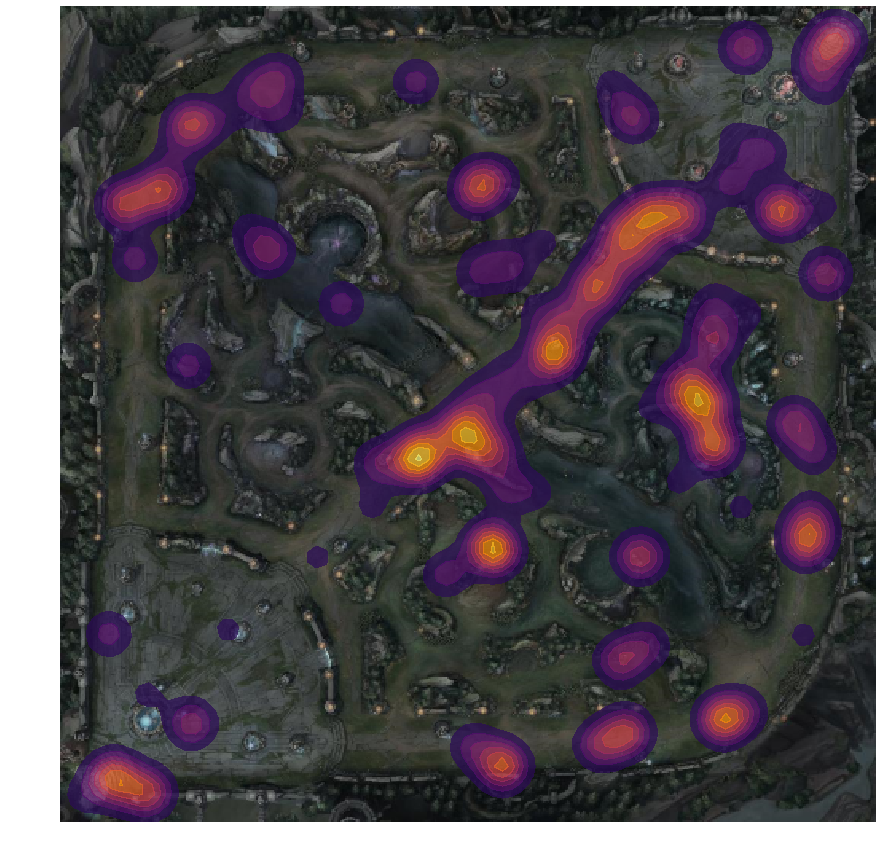

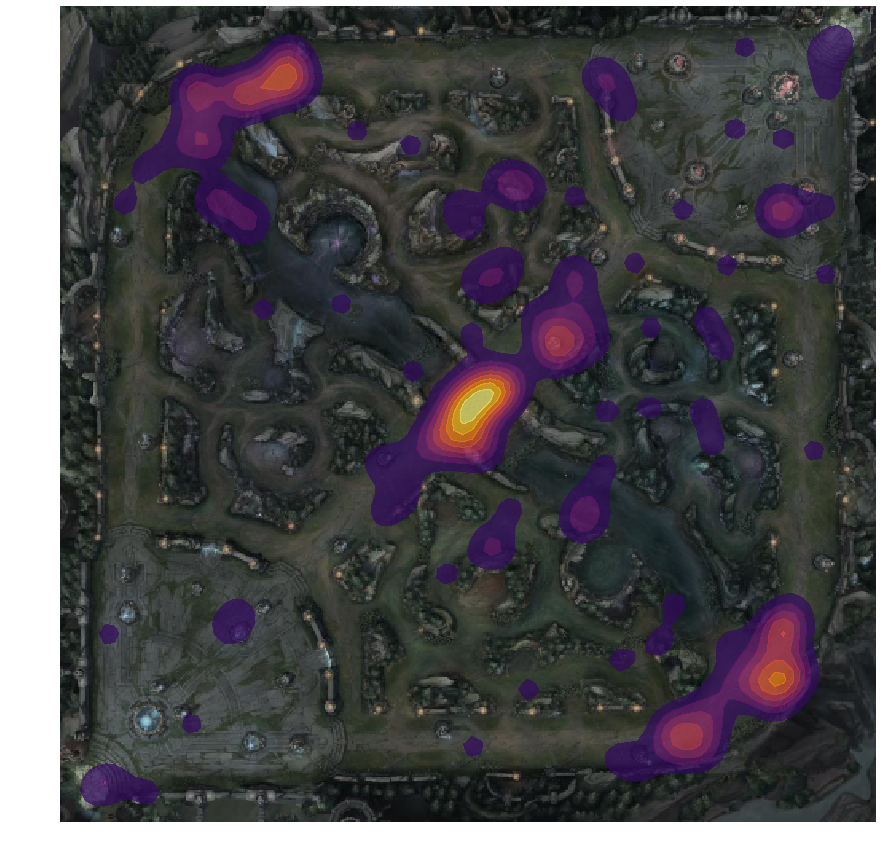

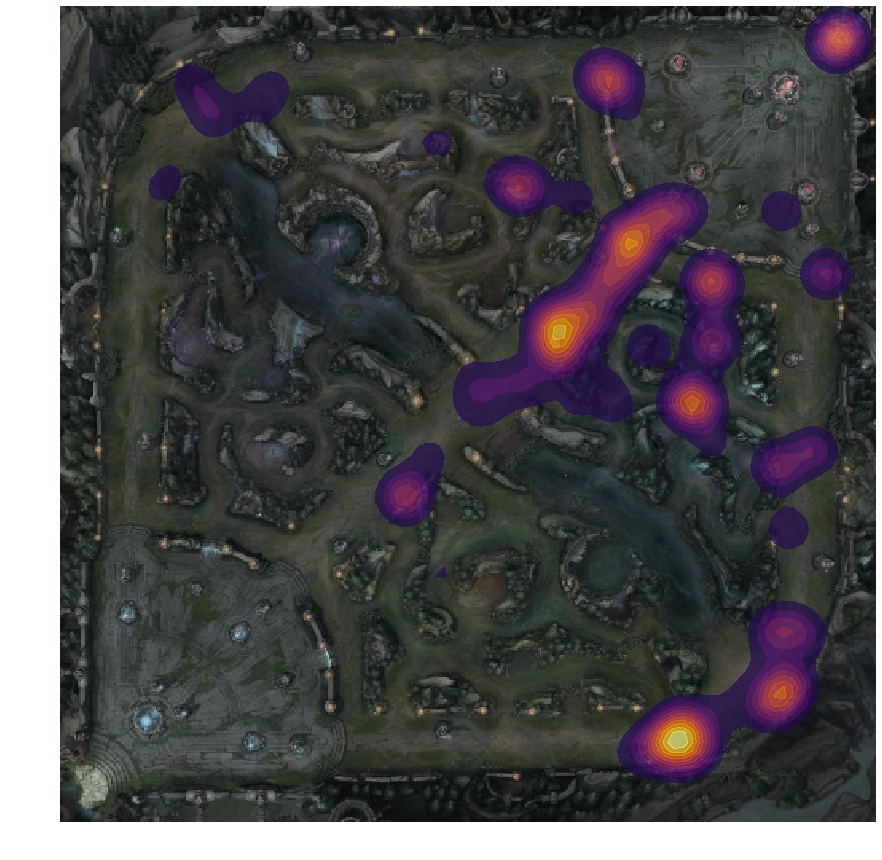

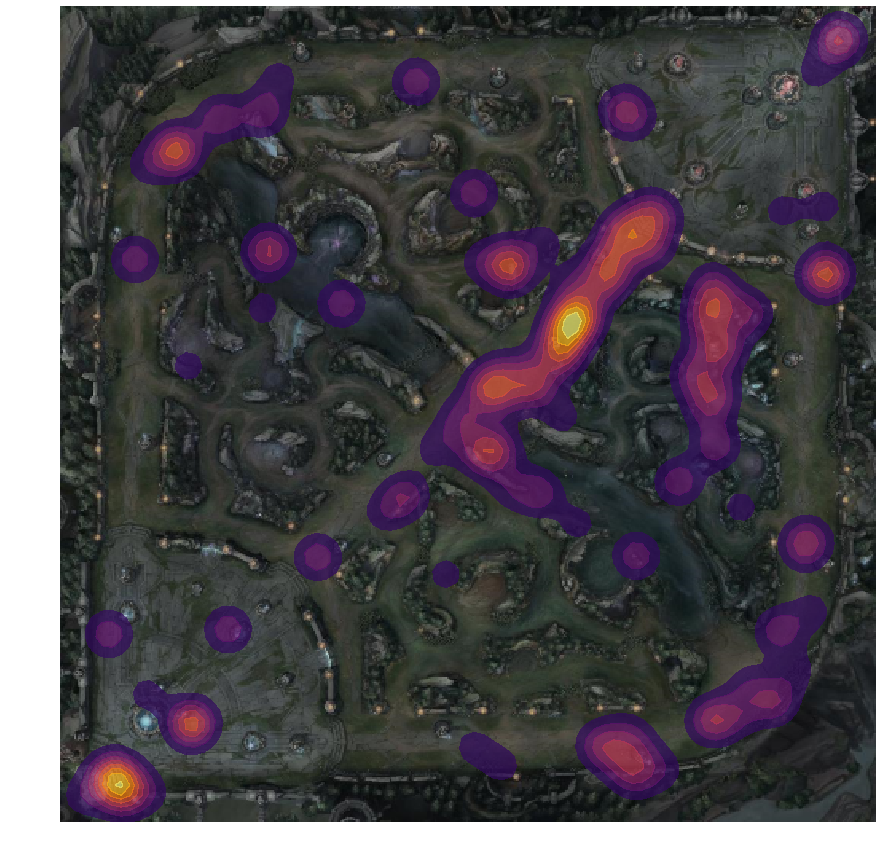

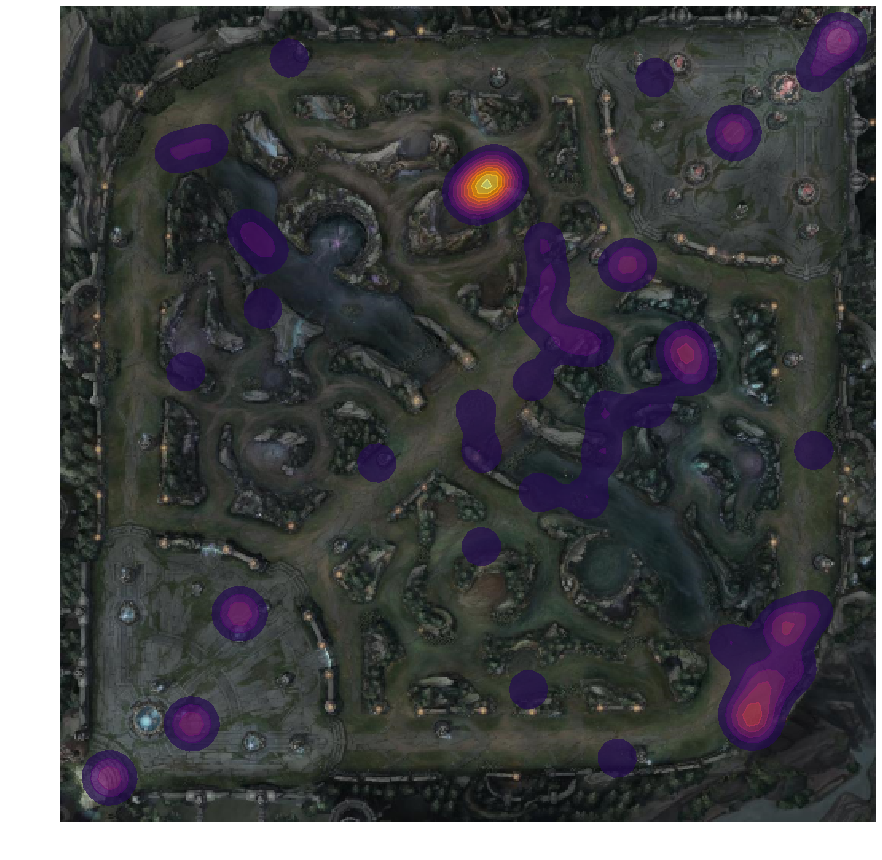

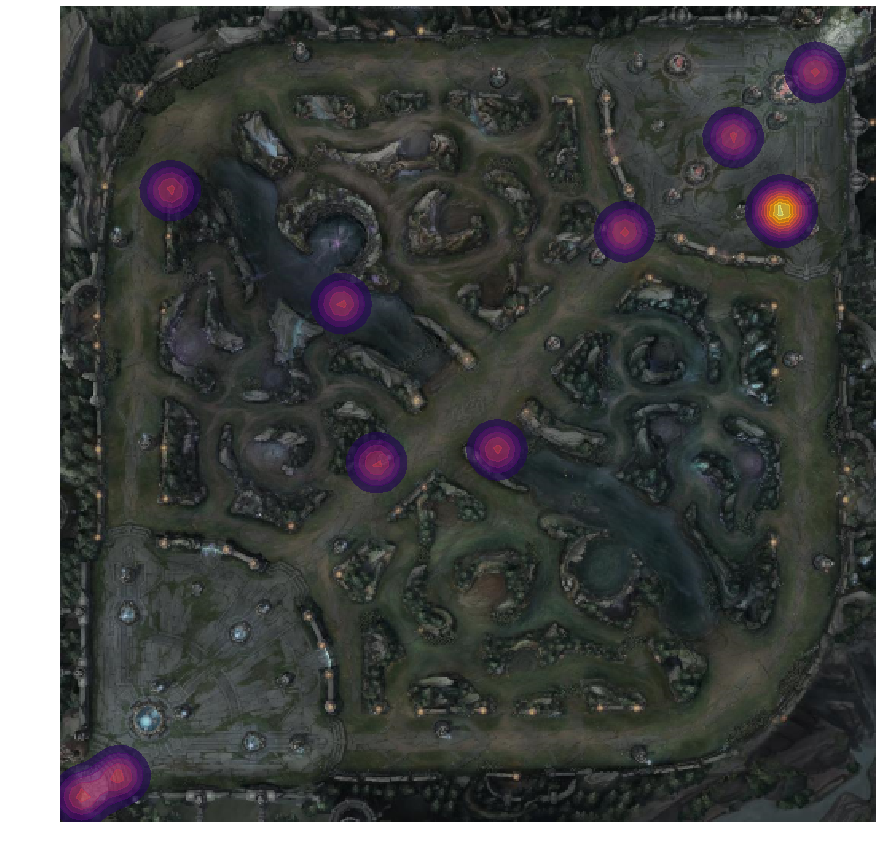

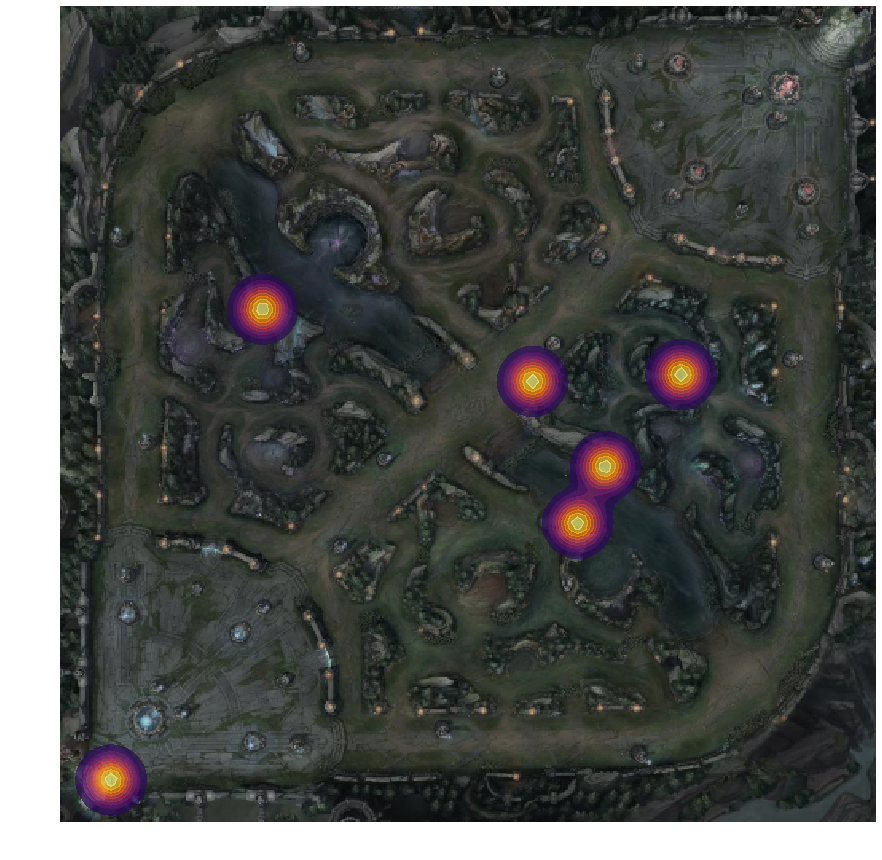

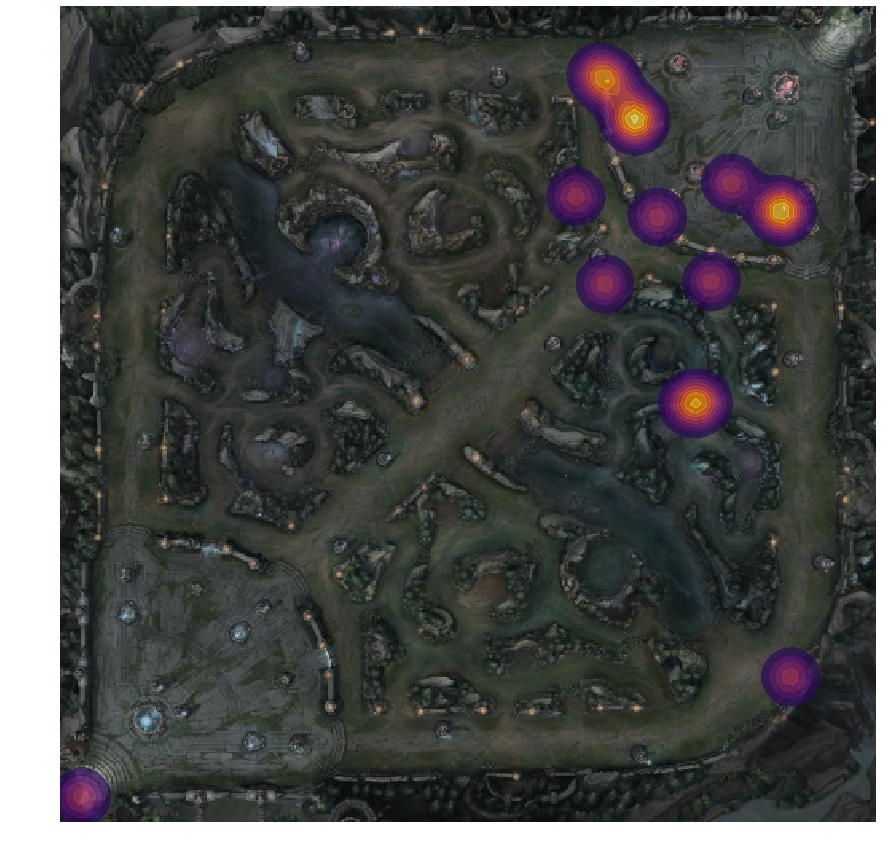

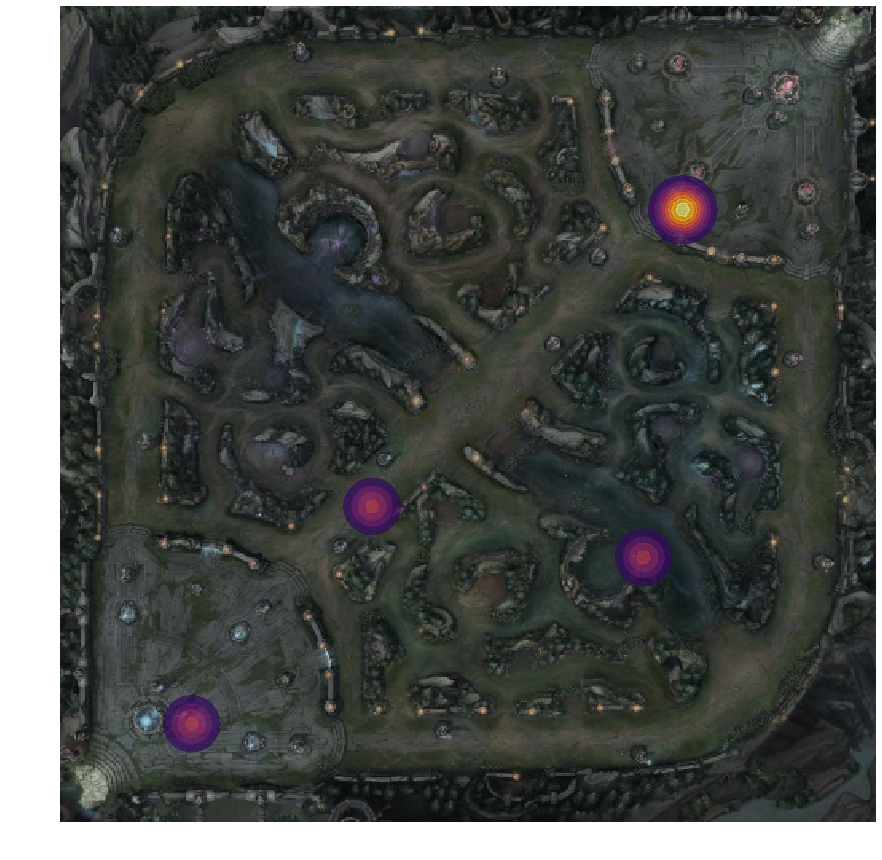

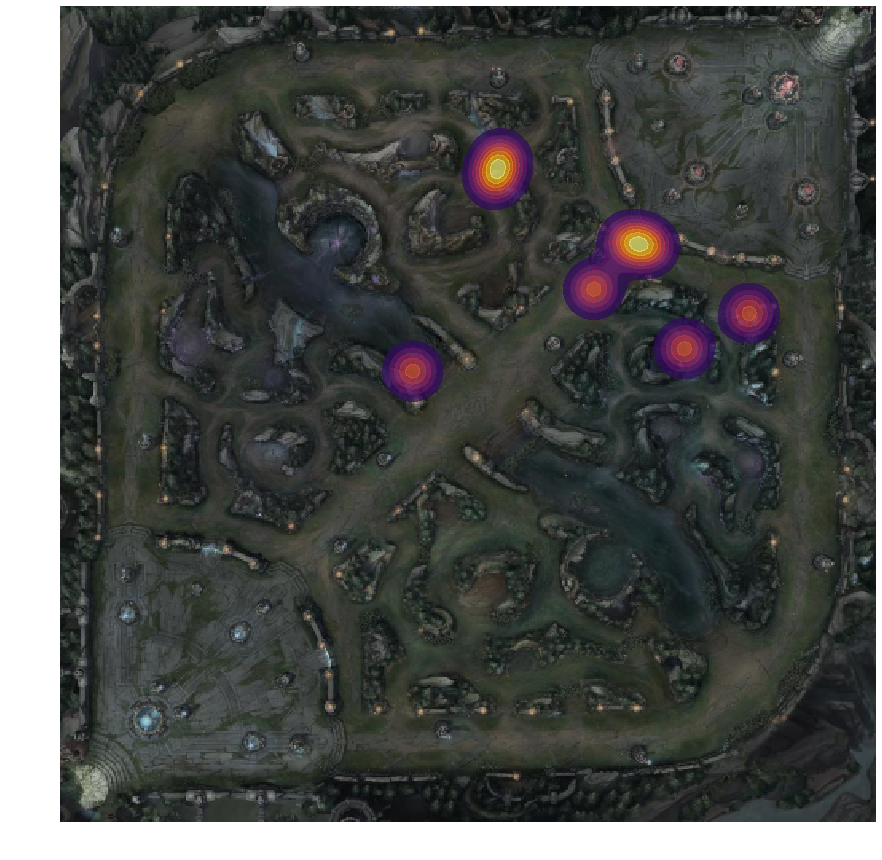

In [10]:
def getHeatmapByEvent():
    # create an heatmap of positions for each event
    for event in allpositionsseqdf.eventtype.unique():
        df = allpositionsseqdf[allpositionsseqdf.eventtype == event]
        try:
            stats.genHeatmap_allpositions(df,
                                save=save, imgname='heatmap_'+event)
        except Exception as e:
            print(e)
getHeatmapByEvent()

The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.


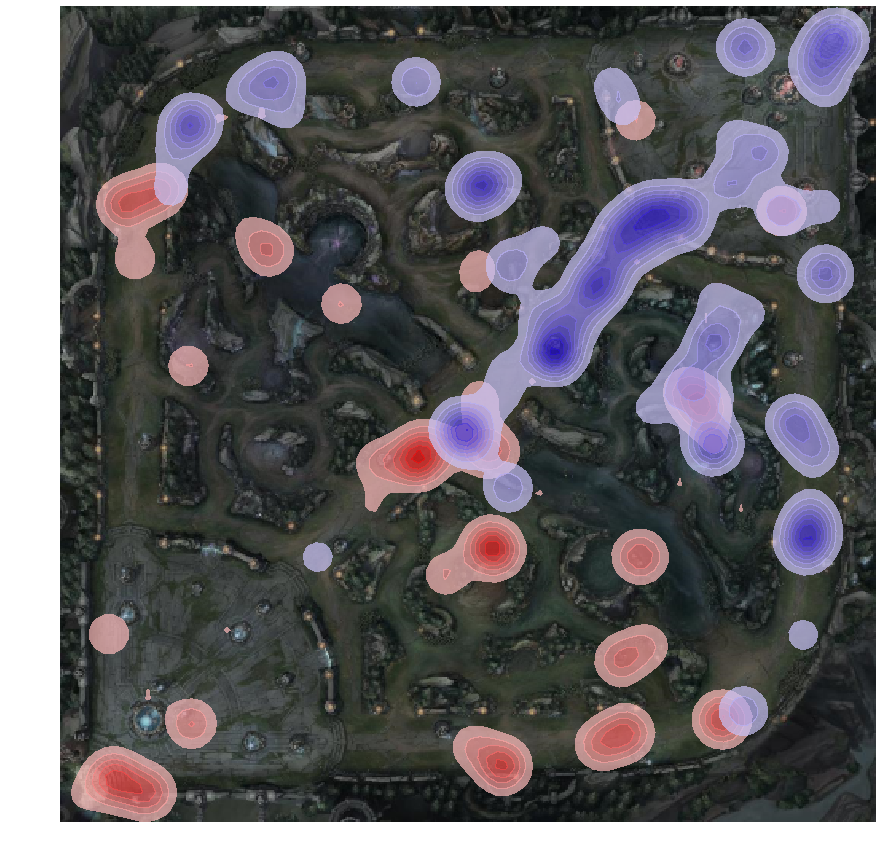

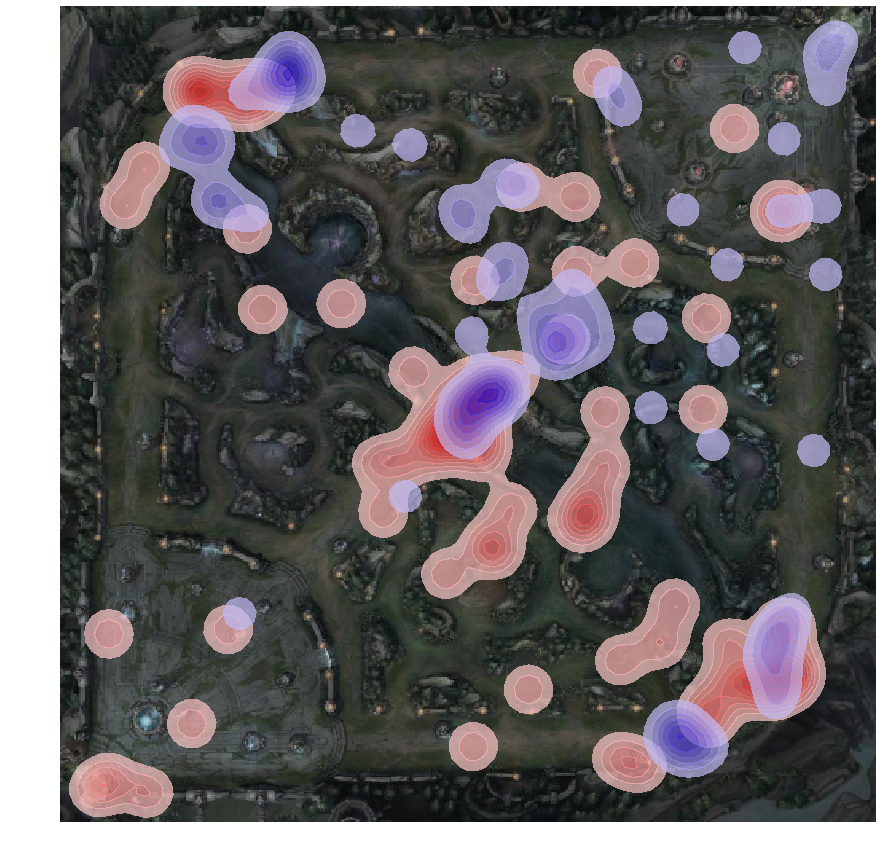

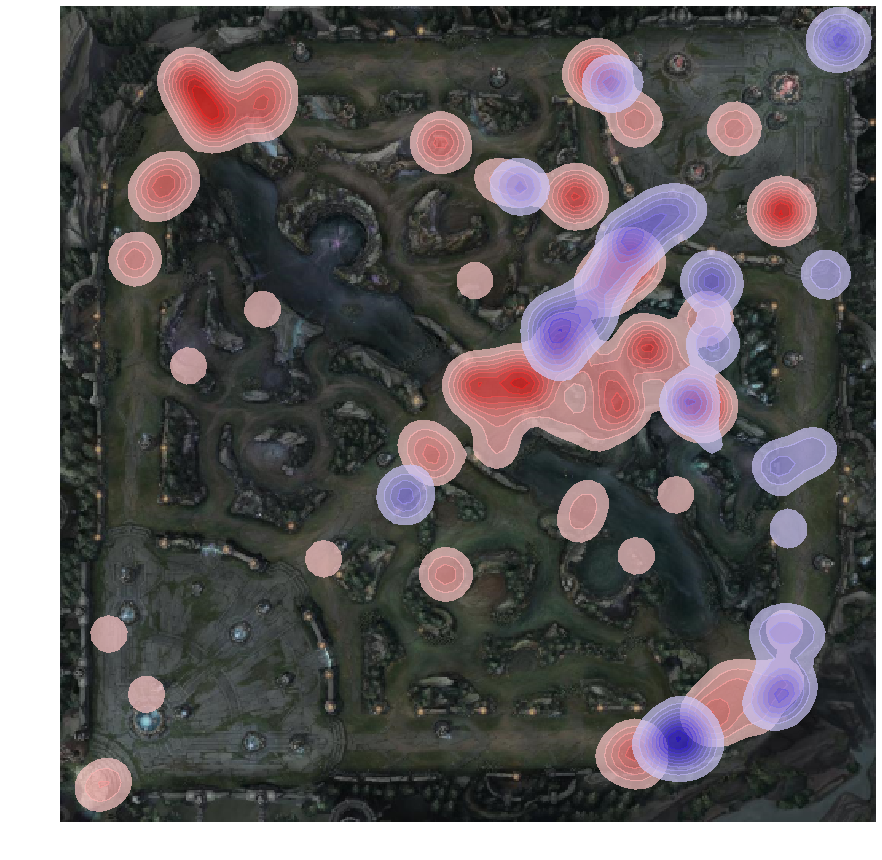

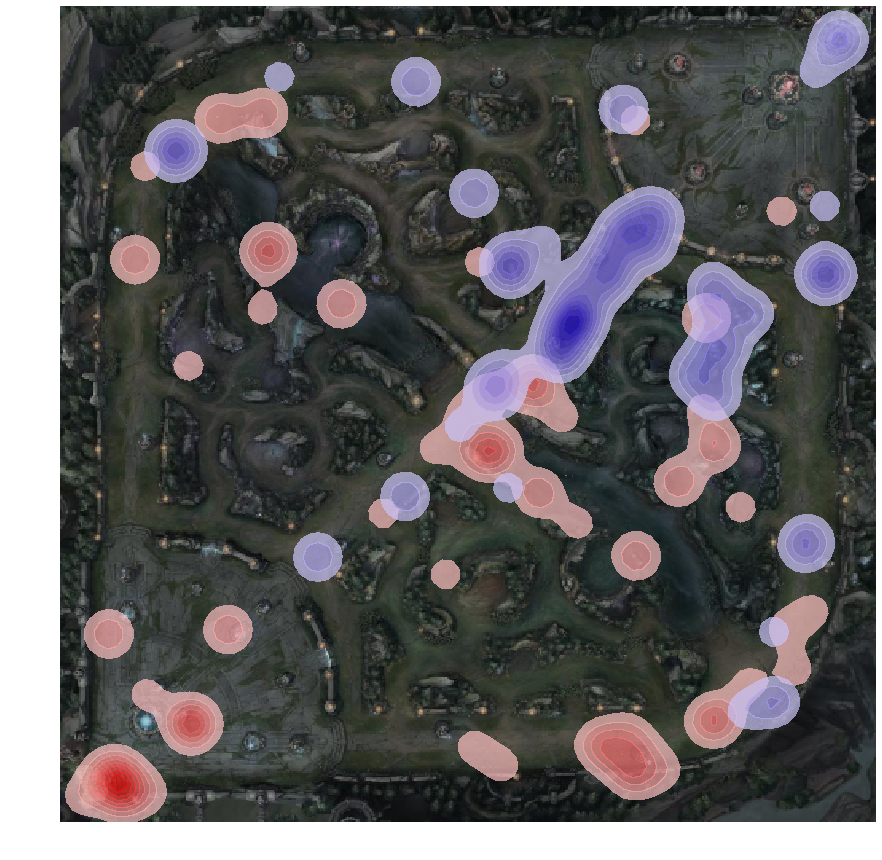

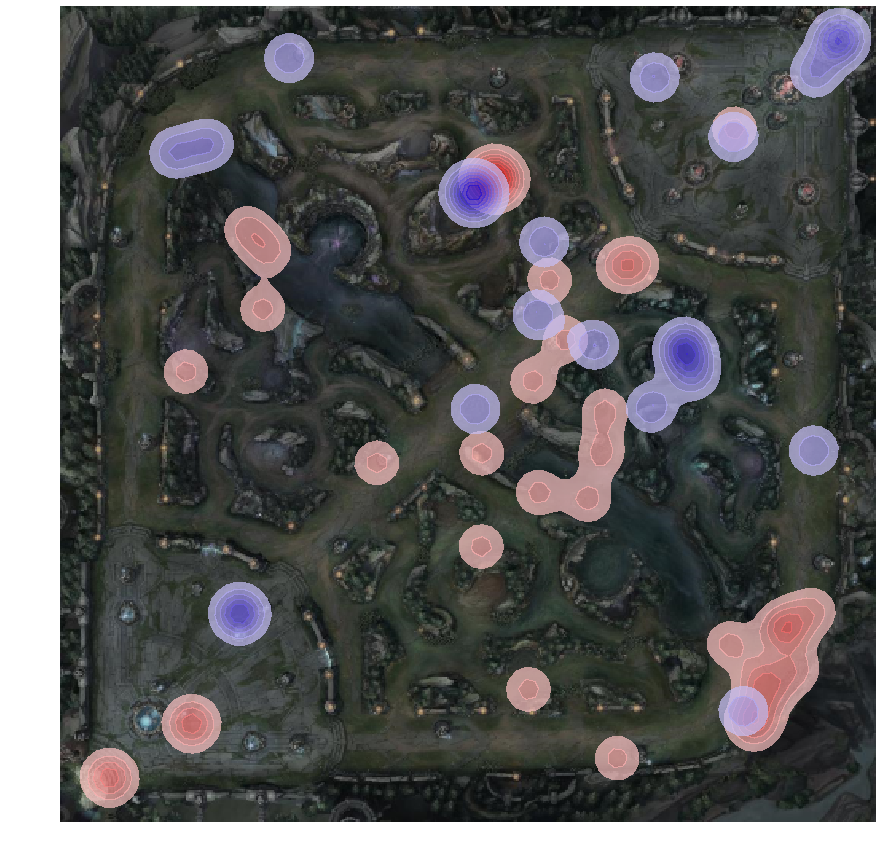

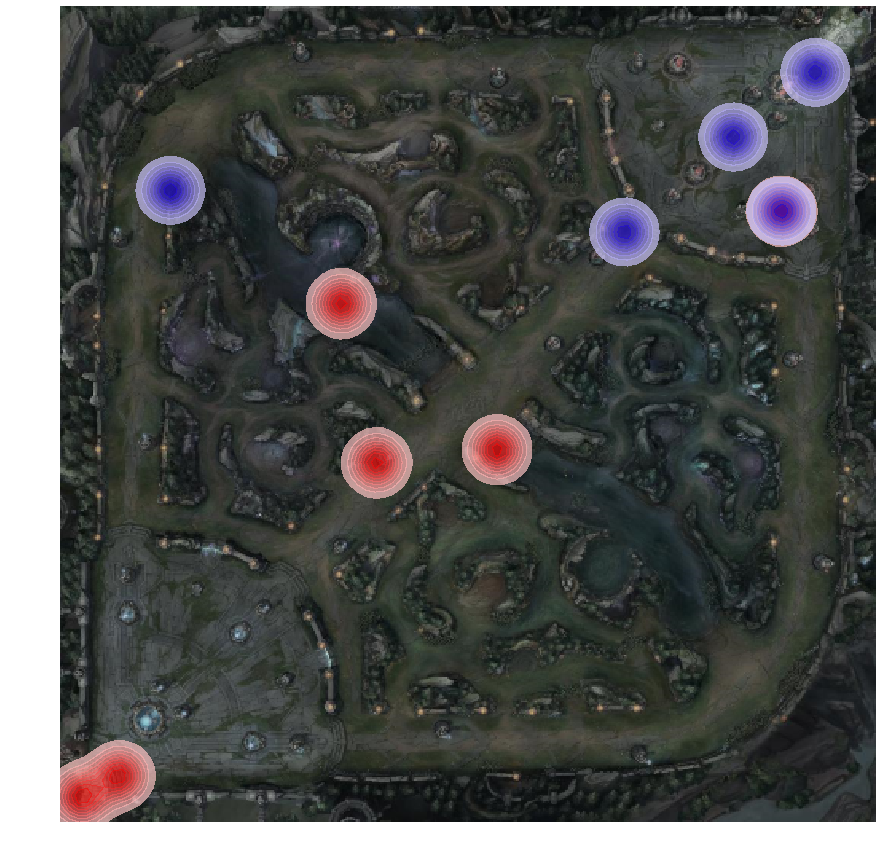

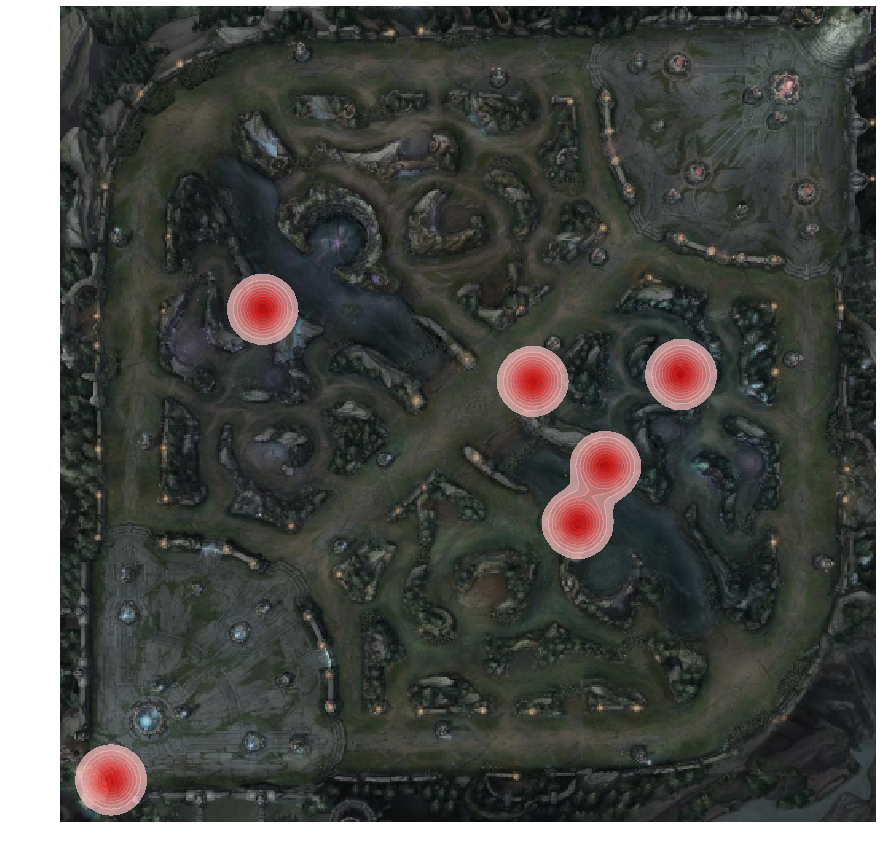

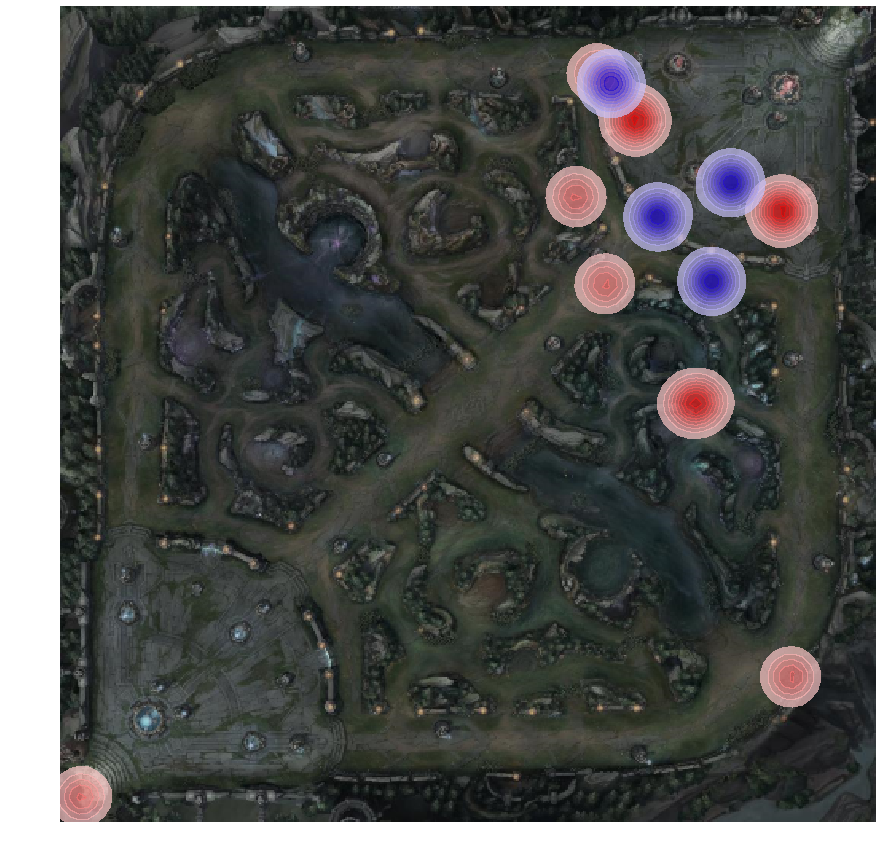

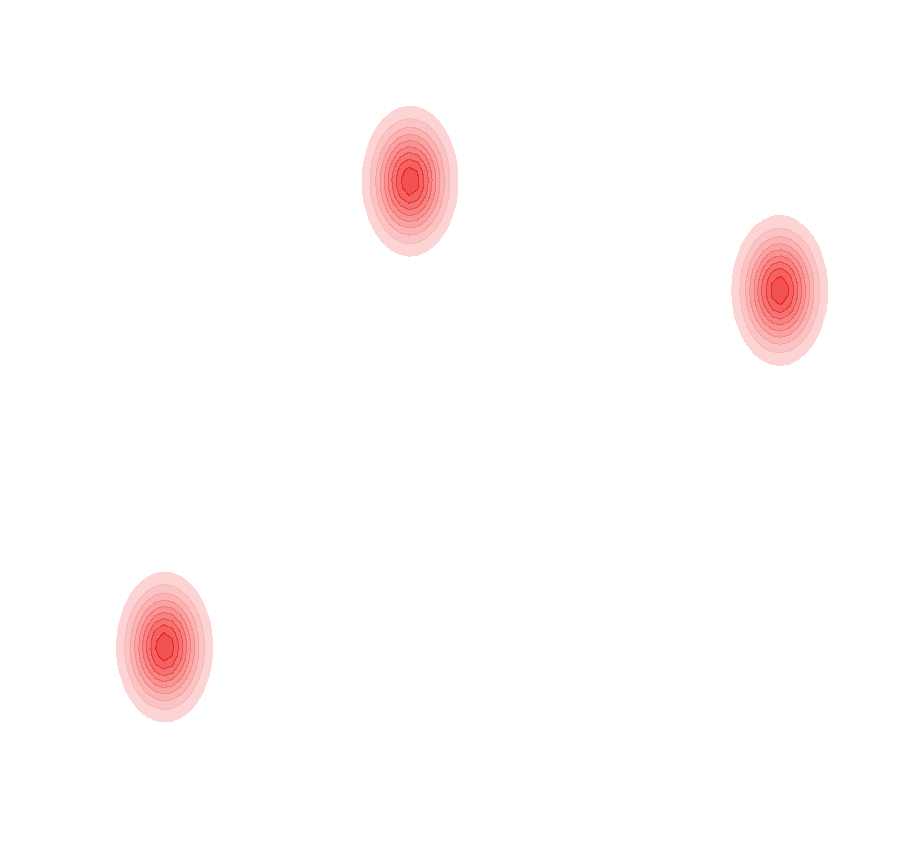

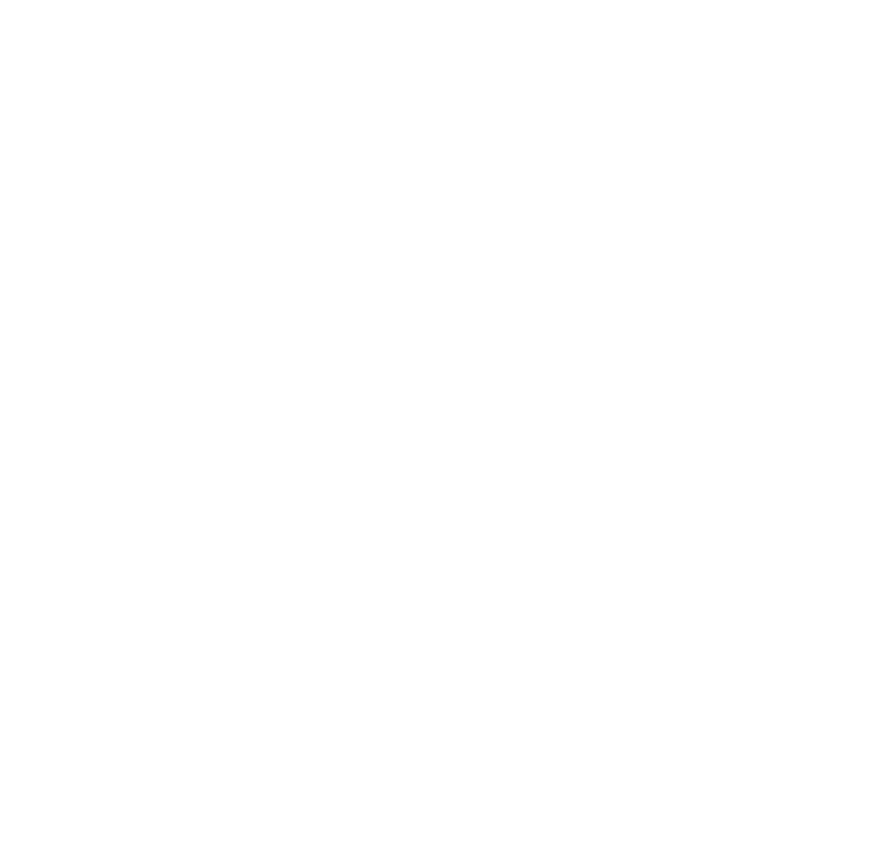

In [9]:
def getHeatmap_byTeam_ByEvent():
    # create an heatmap of positions by team for each event
    for event in allpositionsseqdf.eventtype.unique():

        df = allpositionsseqdf[allpositionsseqdf.eventtype == event]
        try:
            stats.genHeatmap_allTeamPositions(df[df.team=='blue'],
                                df[df.team=='red'],
                                save=True, imgname='heatmap_team_'+event)
        except Exception as e:
            print(e)
getHeatmap_byTeam_ByEvent()

The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.
The number of observations must be larger than the number of variables.


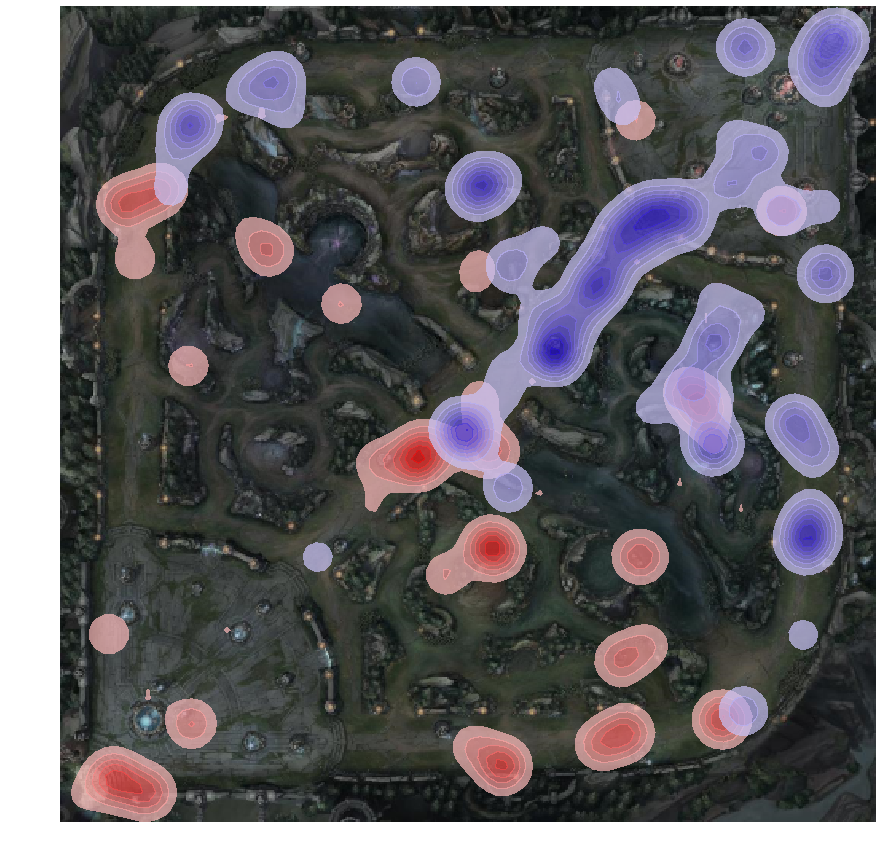

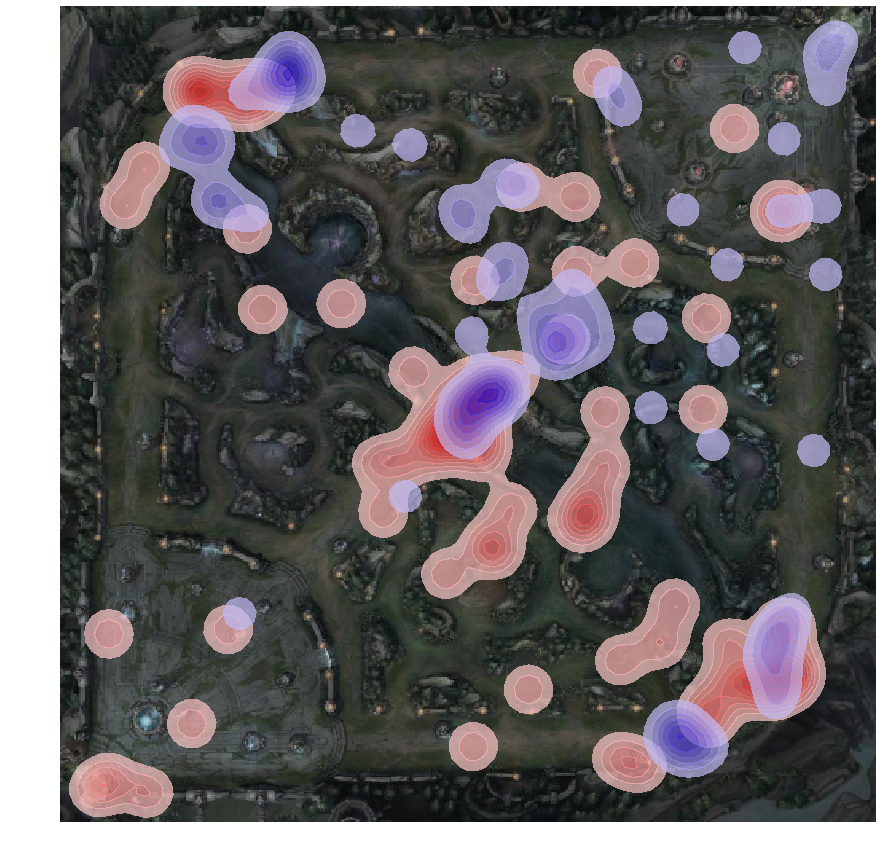

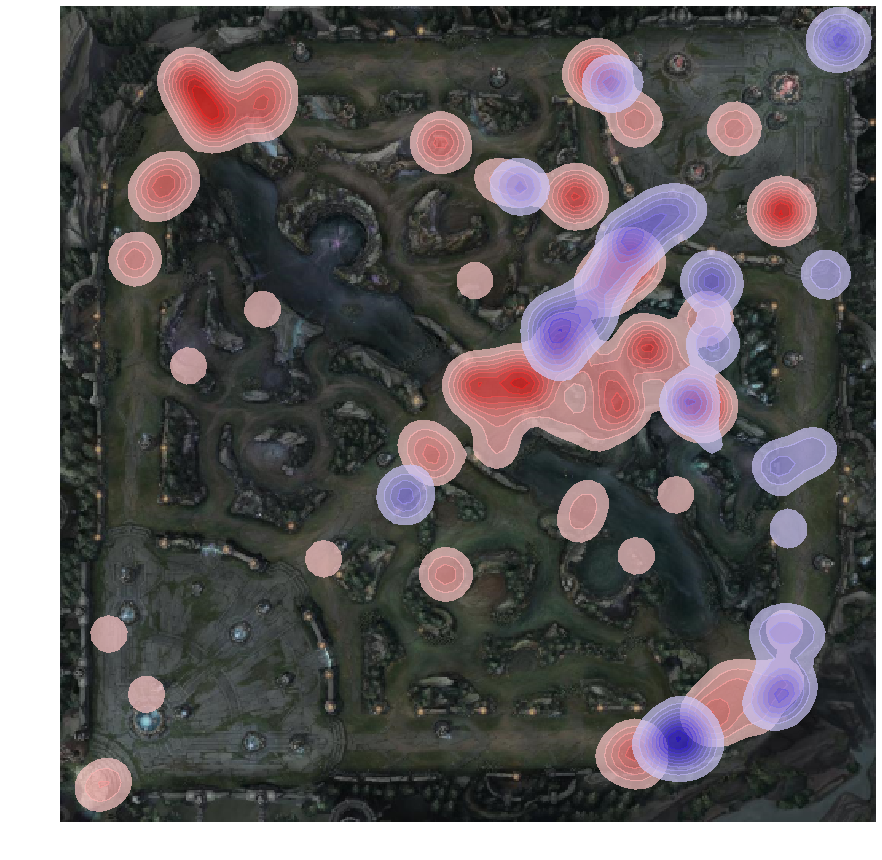

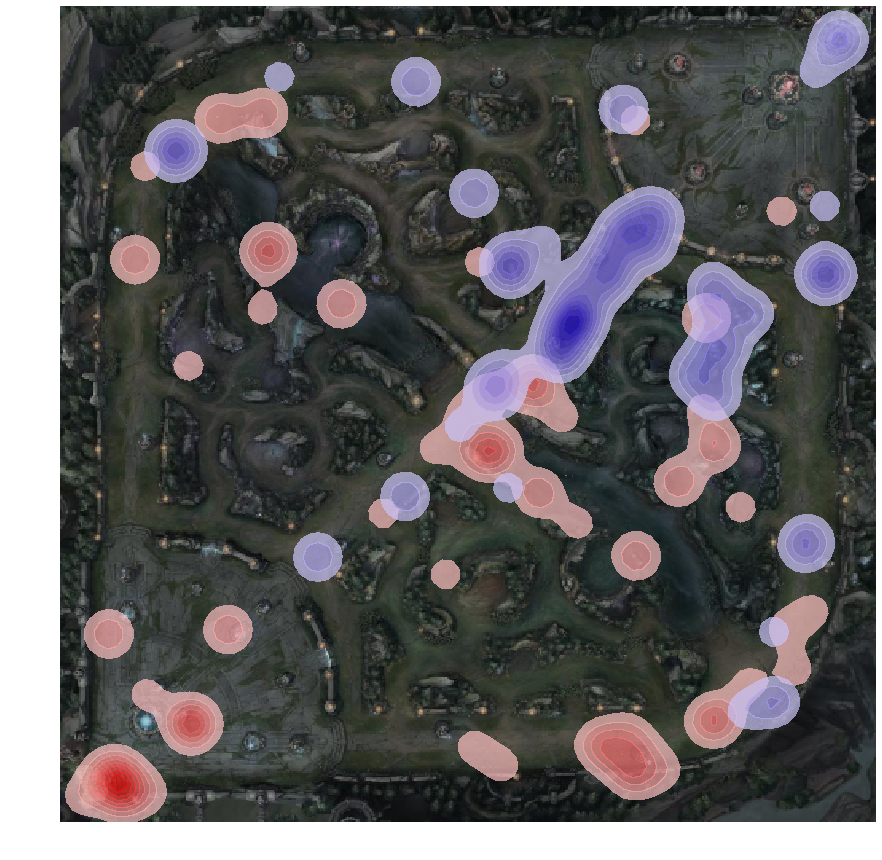

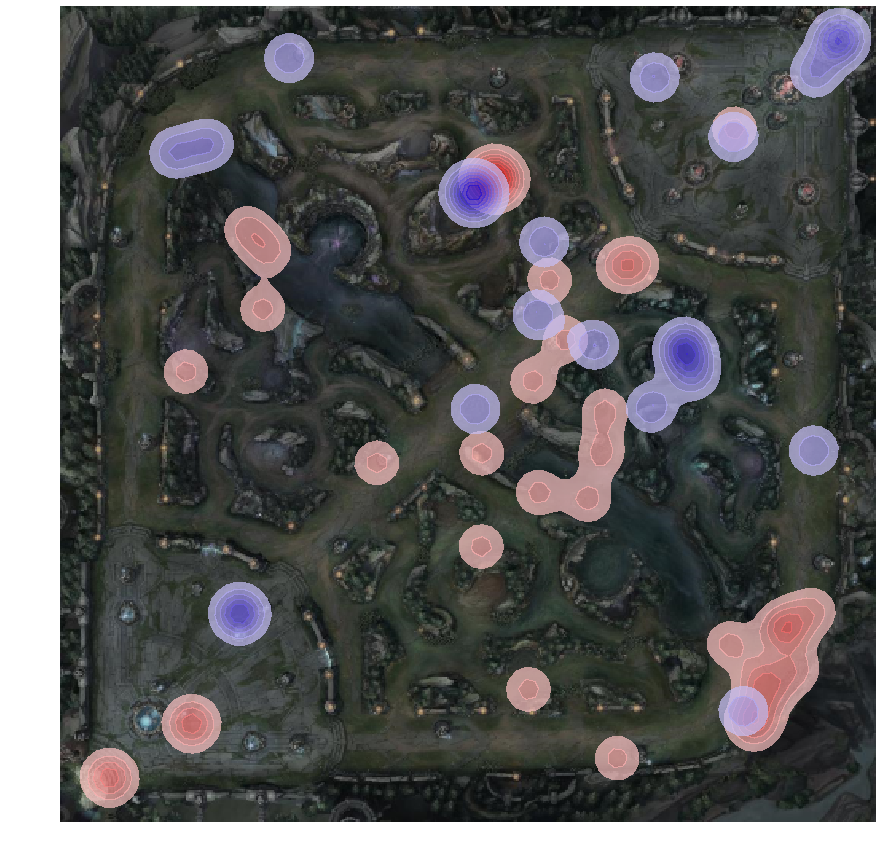

...

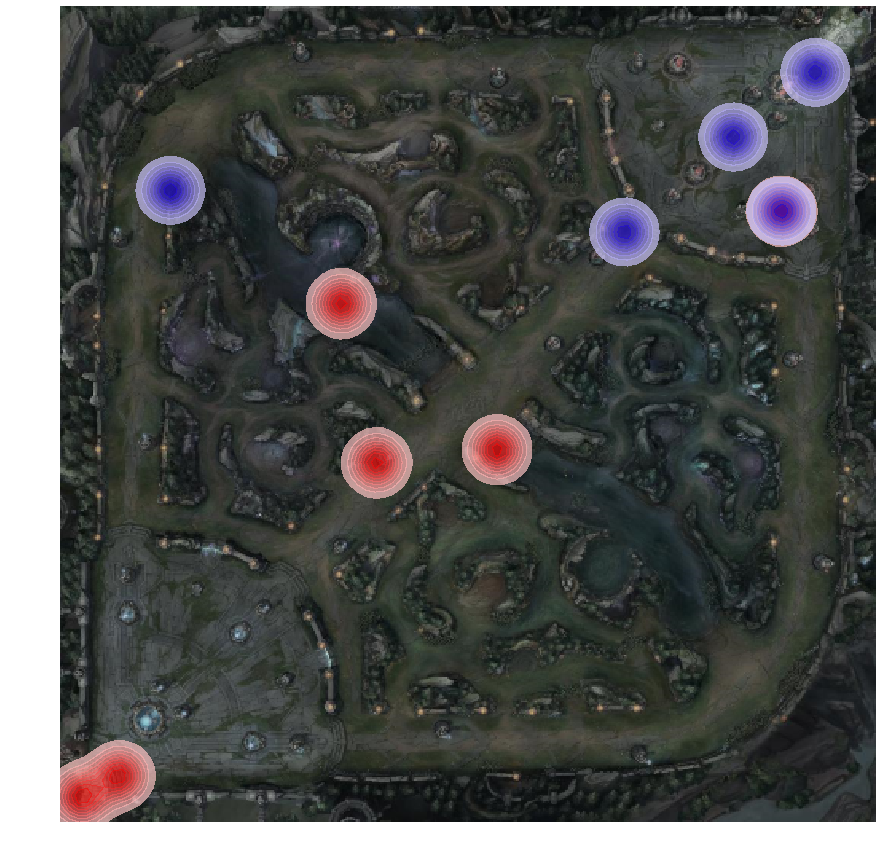

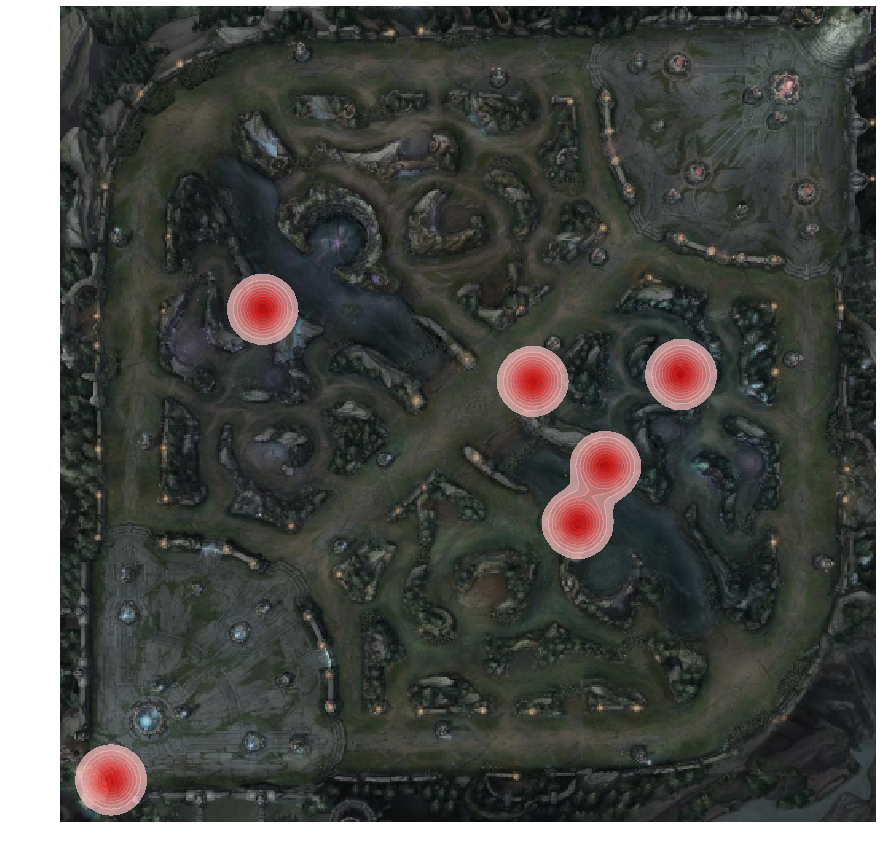

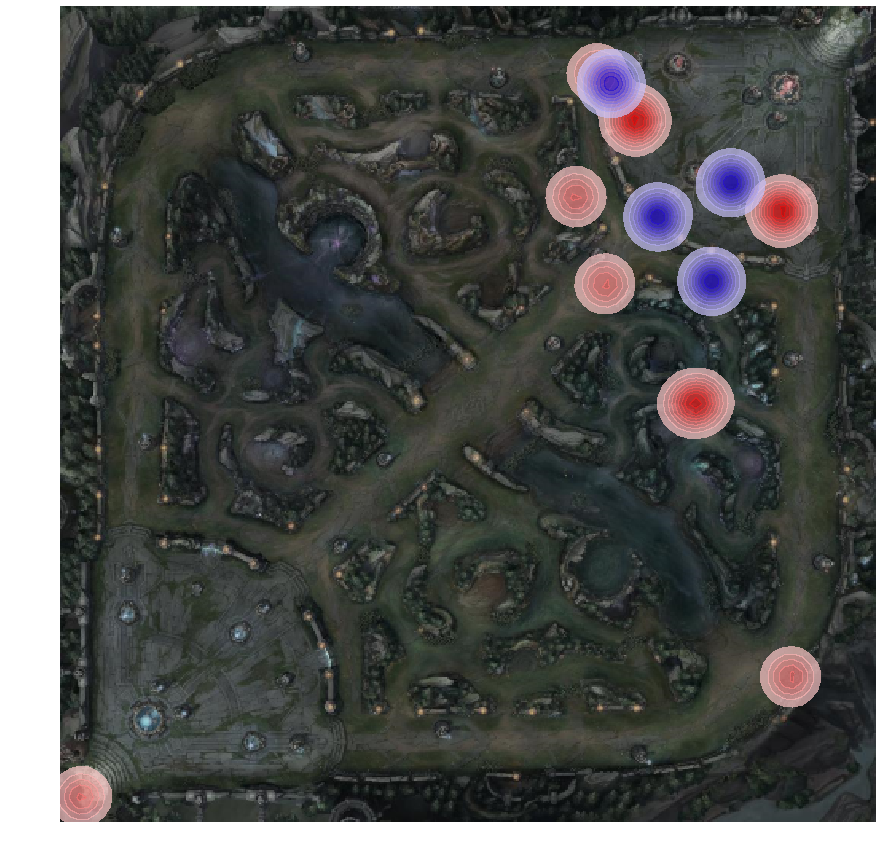

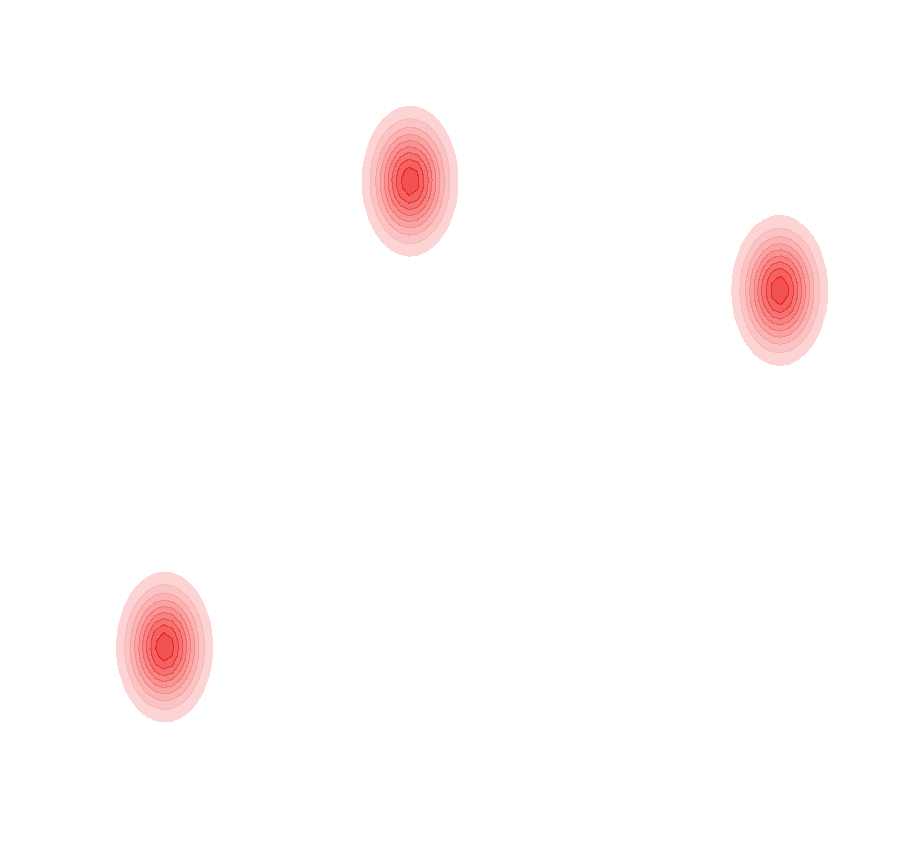

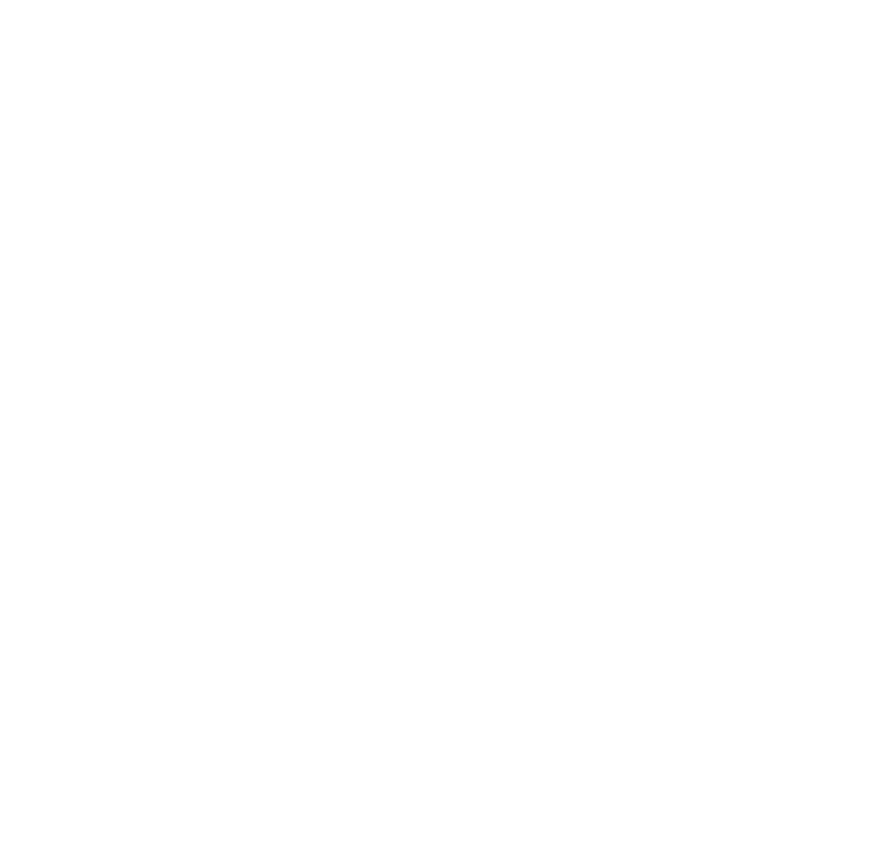

In [71]:
"""
comments about the wards placed and the players movements:
there is a correlation between the wards placed and the movements of players
"""
# we are analysing some timestamps to see if there is a correlation between the event and the positions of the players in a particular game phase.
phases = [10,15,16,26]
for phase in phases:
    for event in allpositionsseqdf.eventtype.unique():
        df = allpositionsseqdf[allpositionsseqdf.eventtype == event]
        try:
            stats.genHeatmap_allTeamPositions(df[df.team=='blue'],
                                df[df.team=='red'],
                                save=save, imgname='heatmap_team_'+event+str(phase+1))
        except Exception as e:
            print(e)

## Let's look at the players' performance data

In [19]:
# load the dataframe containing the info:
playerContextdf = utils.load_obj('dfplayersContext_game')
# create a column to encode the players' belonging teams
playerContextdf['team'] = allpositionsseqdf.playerId.apply(lambda x: 'blue' if int(x)<6 else 'red')
# normalise the timestamp, since 1 minute = 60000 ms
playerContextdf['normts'] = playerContextdf.timestamp//60000

In [21]:
# look at the variables
playerContextdf.head()

,p,timestamp,currentGold,totalGold,level,xp,minionsKilled,jungleMinionsKilled,dominionScore,team,normts
0,1,0,500,500,1,0,0,0,0,blue,0
1,2,0,500,500,1,0,0,0,0,blue,0
2,3,0,500,500,1,0,0,0,0,blue,0
3,4,0,500,500,1,0,0,0,0,blue,0
4,5,0,500,500,1,0,0,0,0,red,0


Text(0, 0.5, 'gold earned')

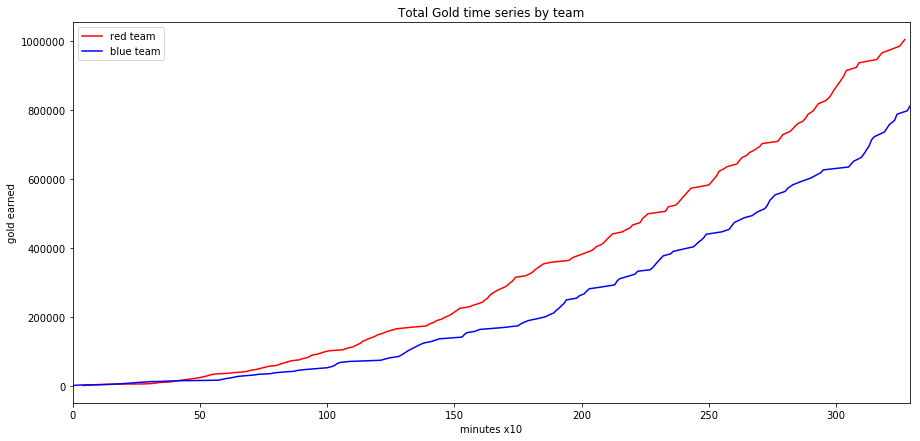

In [24]:
# plot the gold earned by each team throughout the whole game
fig, ax = plt.subplots(figsize=(15,7))
ax.set_title('Total Gold time series by team')
playerContextdf[playerContextdf['team']=='red'].totalGold.cumsum().plot(c='r', label='red team')
playerContextdf[playerContextdf['team']=='blue'].totalGold.cumsum().plot(c='b', label='blue team')
ax.legend()
ax.set_xlabel('minutes x10')
ax.set_ylabel('gold earned')
#stats.saveImage('timeseries_totalgold_teams') # uncomment this line to save the figure

In [59]:
killevents = ['CHAMPION_KILL', 'ELITE_MONSTER_KILL', 'BUILDING_KILL', 'ITEM_UNDO', 'WARD_KILL']
dfkills = allpositionsseqdf[allpositionsseqdf.eventtype.isin(killevents)]

In [70]:
dfkills.head()

,eventtype,gametimestamp,playerId,timestamp,x,y,team
62,CHAMPION_KILL,180055,2,2,12872,2638,blue
64,CHAMPION_KILL,180055,5,2,12309,3276,blue
88,CHAMPION_KILL,240065,3,3,9718,5929,blue
122,CHAMPION_KILL,300068,9,4,13865,6829,red
123,CHAMPION_KILL,300068,5,4,13050,2405,blue


In [14]:
playerContextdf['normts'] = playerContextdf.timestamp//60000

In [15]:
allpositionsdf['normts'] = allpositionsdf['timestamp']//60000

In [16]:
poscontextdf = allpositionsdf.merge(playerContextdf, left_on='normts', right_on='normts')

In [17]:
poscontextdf.head()

,playerid,x,y,timestamp_x,team_x,win,intplayer,normts,p,timestamp_y,currentGold,totalGold,level,xp,minionsKilled,jungleMinionsKilled,dominionScore,team_y
0,1,560,581,0,blue,Win,1,0,1,0,500,500,1,0,0,0,0,blue
1,1,560,581,0,blue,Win,1,0,2,0,500,500,1,0,0,0,0,blue
2,1,560,581,0,blue,Win,1,0,3,0,500,500,1,0,0,0,0,blue
3,1,560,581,0,blue,Win,1,0,4,0,500,500,1,0,0,0,0,blue
4,1,560,581,0,blue,Win,1,0,5,0,500,500,1,0,0,0,0,red


In [26]:

def res_median(df,gamephase):
    """get dataframe with coordinates per gamer (10 row) into specific game phase
       and get median of point per team
    """
    df_ = df[df.timestamp//60000 +1 == gamephase]
    x_red = df_[df_.team=="red"].x
    y_red = df_[df_.team=="red"].y
    x_blue = df_[df_.team=="blue"].x
    y_blue = df_[df_.team=="blue"].y
    res_red = sts.siegelslopes(y_red, x_red)
    res_blue = sts.siegelslopes(y_blue, x_blue)
    return (df_, x_red, y_red, x_blue, y_blue, res_red, res_blue)


In [98]:
phases = np.array([10,15,16,26])

In [92]:
poseqphases = allpositionsseqdf[allpositionsseqdf.timestamp.isin(phases)]
poseqphasests = poseqphases[poseqphases.timestamp==16]
poseqphasests[poseqphasests.team=='blue']

,eventtype,gametimestamp,playerId,timestamp,x,y,team
516,ITEM_PURCHASED,1020317,5,16,5175,9531,blue
517,ITEM_DESTROYED,1020317,5,16,5175,9531,blue
518,ITEM_DESTROYED,1020317,5,16,5175,9531,blue
522,WARD_PLACED,1020317,4,16,7622,8064,blue
523,ITEM_SOLD,1020317,5,16,5175,9531,blue
525,ITEM_PURCHASED,1020317,5,16,5175,9531,blue
531,BUILDING_KILL,1020317,3,16,394,461,blue
533,SKILL_LEVEL_UP,1020317,4,16,7622,8064,blue
534,WARD_PLACED,1020317,4,16,7622,8064,blue
536,SKILL_LEVEL_UP,1020317,5,16,5175,9531,blue


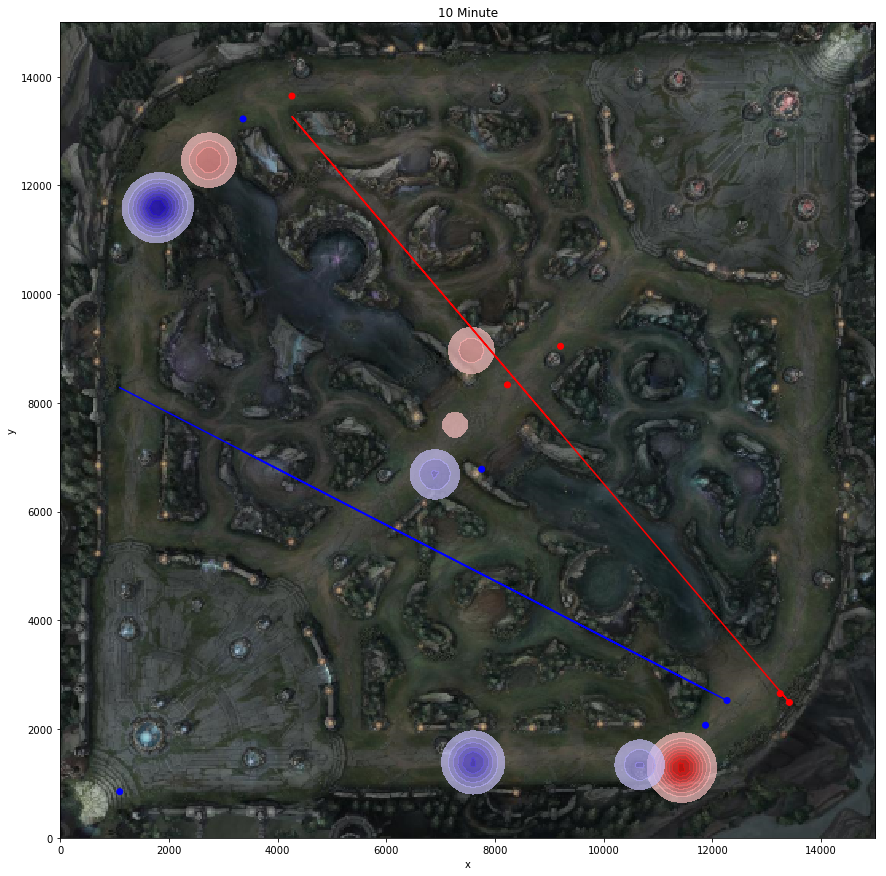

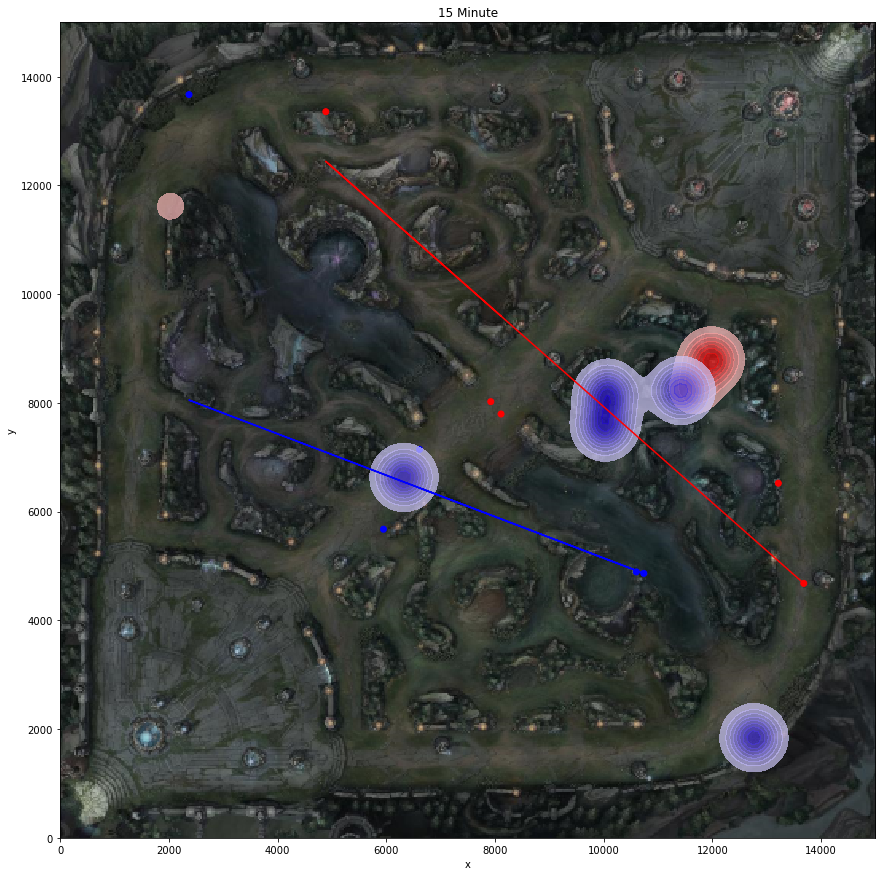

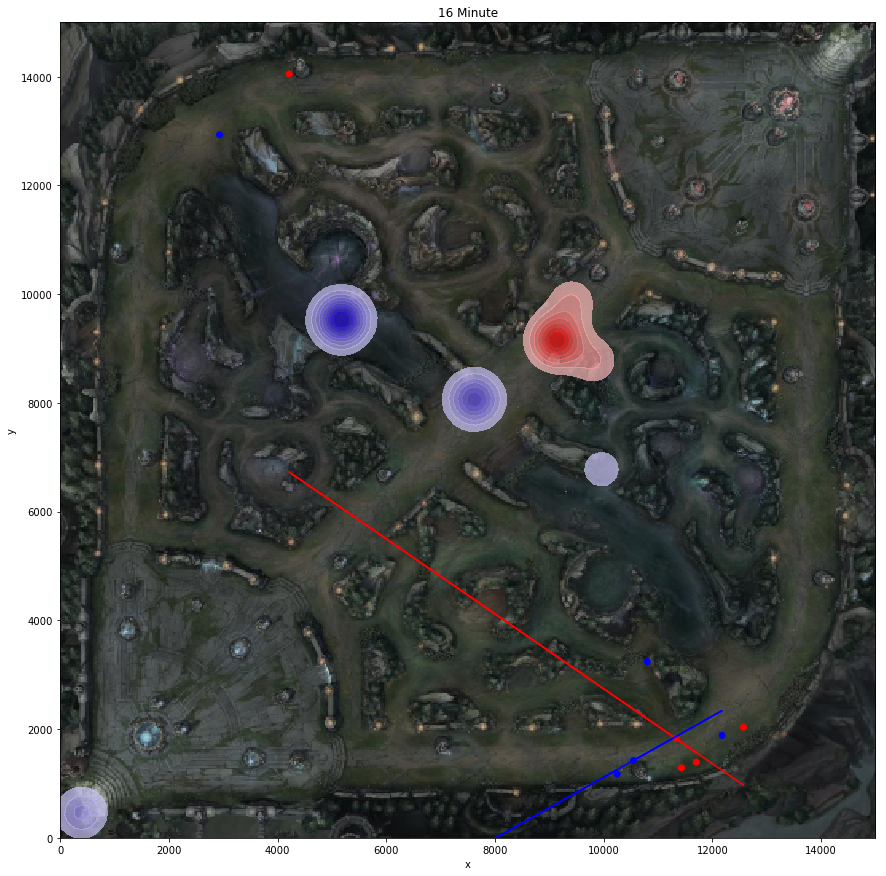

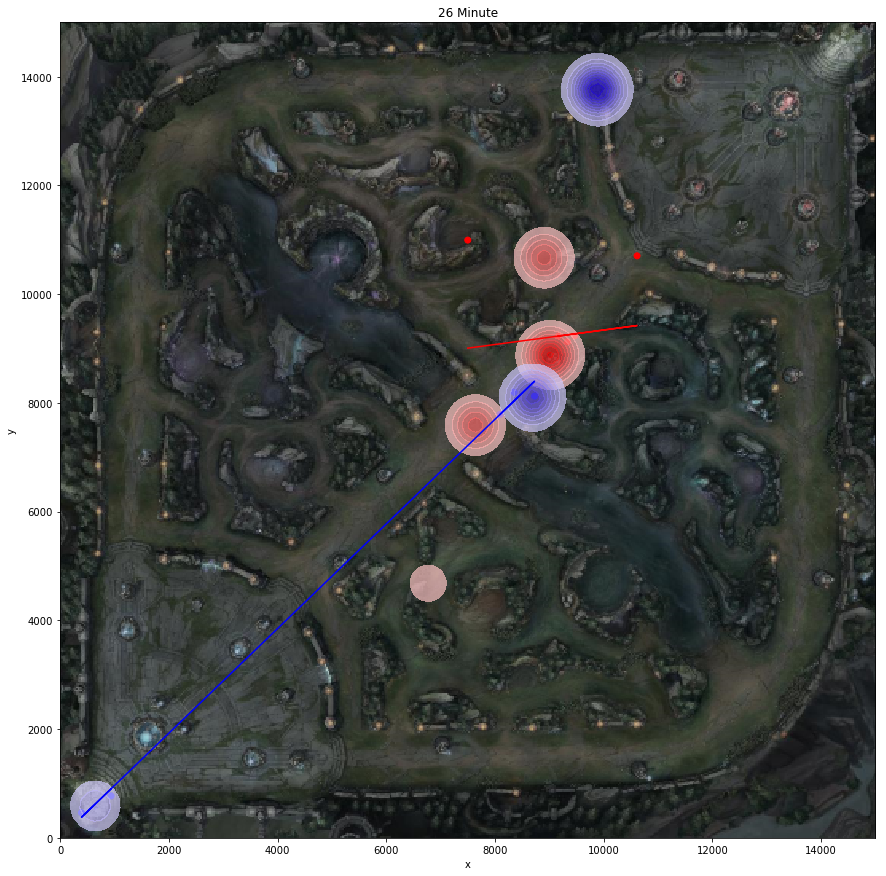

In [99]:
df = allpositionsdf
allposdata = []


for phase in phases:
    # df_mid and linear regretion with median
    df_,x_red, y_red, x_blue, y_blue,res_red, res_blue = res_median(df,phase)
    # plot early phase
    img = plt.imread("images/map.png")
    fig, ax = plt.subplots(figsize=(15,15))
    ax = plt.gca()
    ax.set_title(str(phase) + ' Minute')
    ax.set
    ax.plot(x_red, res_red[1] + res_red[0] * x_red, 'r-')
    ax.plot(x_blue, res_blue[1] + res_blue[0] * x_blue, 'b-')
    plt.scatter(df_.x,df_.y,color=df_.team)
    
    posdf = poseqphases[poseqphases.timestamp==phase]

    posdfr = posdf[posdf.team=='red']
    posdfb = posdf[posdf.team=='blue']
    

    sns.kdeplot(posdfr.x, posdfr.y, color="#eb0000", 
                shade=True, shade_lowest=False, 
                cut=5, ax=ax, alpha=0.7, bw=300)   
    
    sns.kdeplot(posdfb.x, posdfb.y, color="#1800cc", 
                shade=True, shade_lowest=False, 
                cut=5, ax=ax, alpha=0.7, bw=300)
   
    ax.imshow(img, extent=[0, 15000, 0, 15000])